In [1]:
%load_ext autoreload

# always reload modules marked with "%aimport"
%autoreload 1
import os
import sys
# add the 'src' directory as one where we can import modules
src_dir = os.path.join(os.getcwd(), os.pardir, 'src')
sys.path.append(src_dir)

In [2]:
import matplotlib.pyplot as plt, mpld3
import plotly.express as px
import seaborn as sns
import ipywidgets as widgets
%matplotlib inline
from dotenv import load_dotenv
%aimport settings
import settings
import pandas as pd
import numpy as np
import seaborn as sns
from scipy.ndimage.filters import gaussian_filter
import joypy

maxsize=3000
np.set_printoptions(threshold=sys.maxsize)
pd.options.display.max_columns = 999
pd.options.display.max_rows = 352905

In [3]:
import ipywidgets as widgets 

In [4]:
season_plays_16_17 = pd.read_csv(settings.processed_data + "/season_plays_2016.csv")
season_plays_17_18 = pd.read_csv(settings.processed_data + "/season_plays_2017.csv")
season_plays_18_19 = pd.read_csv(settings.processed_data + "/season_plays_2018.csv")
season_plays_19_20 = pd.read_csv(settings.processed_data + "/season_plays_2019.csv")
season_plays_20_21 = pd.read_csv(settings.processed_data + "/season_plays_2020.csv")


In [64]:
print('min and max time 16_17:',season_plays_16_17.game_time.min(), season_plays_16_17.game_time.max())
print('min and max time 17_18:',season_plays_17_18.game_time.min(), season_plays_17_18.game_time.max())
print('min and max time 18_19:',season_plays_18_19.game_time.min(), season_plays_18_19.game_time.max()) 
print('min and max time 19_20',season_plays_19_20.game_time.min(), season_plays_19_20.game_time.max())
print('min and max time 19_20',season_plays_20_21.game_time.min(), season_plays_20_21.game_time.max())


min and max time 16_17: 2016-09-25T17:09:01Z 2017-06-12T02:57:05Z
min and max time 17_18: 2017-09-16T21:17:25Z 2018-06-08T02:59:04Z
min and max time 18_19: 2018-09-16T17:09:34Z 2019-06-13T02:37:20Z
min and max time 19_20 2019-09-15T20:39:17Z 2020-09-29T02:49:05Z
min and max time 19_20 2021-01-13T22:33:00Z 2021-07-08T02:50:30Z


In [9]:
print('shape of season_plays_16_17', season_plays_16_17.shape)
print('shape of season_plays_17_18', season_plays_17_18.shape)
print('shape of season_plays_18_19', season_plays_18_19.shape)
print('shape of season_plays_19_20', season_plays_19_20.shape)


shape of season_plays_16_17 (85465, 20)
shape of season_plays_17_18 (92688, 20)
shape of season_plays_18_19 (91705, 20)
shape of season_plays_19_20 (83060, 20)


In [5]:
df = pd.concat([season_plays_16_17, season_plays_17_18, season_plays_18_19, season_plays_19_20, season_plays_20_21], ignore_index=True)


### Q1 Warm up

In [6]:
summary_7_18 = pd.read_excel(settings.raw_data+'/summary_2017_18.xlsx')
summary_7_18.head()

,Player,Season,Team,S/C,GP,GS,W,L,T,OT,SA,Svs,GA,Sv%,GAA,TOI,SO,G,A,P,PIM
0,Connor Hellebuyck,20172018,WPG,L,67,64,44,11,--,9,"2,048","1,892",156,0.924,2.36,3965:54,6,0,2,2,0
1,Andrei Vasilevskiy,20172018,TBL,L,65,64,44,17,--,3,"2,075","1,908",167,0.920,2.62,3825:11,8,0,2,2,14
2,Pekka Rinne,20172018,NSH,L,59,59,42,13,--,4,"1,840","1,706",134,0.927,2.31,3475:27,8,0,1,1,6
3,Frederik Andersen,20172018,TOR,L,66,66,38,21,--,5,"2,211","2,029",182,0.918,2.81,3888:31,5,0,1,1,2
4,Sergei Bobrovsky,20172018,CBJ,L,65,65,37,22,--,6,"1,993","1,835",158,0.921,2.42,3911:34,5,0,3,3,0


In [7]:
fig = px.bar(
    x=summary_7_18.sort_values('Sv%').head(20)["Sv%"],
    y=summary_7_18.sort_values('Sv%').head(20)['Player'],
    title="Goalie performance by number of game won(Win)",
    barmode="group")

fig.update_layout(
    xaxis=dict(title="Save percentage"),
    yaxis=dict(title="Player"),
)

fig.show()
#fig.write_html("/Users/henaghonia/Desktop/udem/Sem 1/Data science/ift6758-blog-template-main/_includes/q1.html")

In [58]:
fig = px.bar(
    x=summary_7_18.sort_values('W').head(20)["W"],
    y=summary_7_18.sort_values('W').head(20)['Player'],
    title="Goalie performance by number of game won(Win)",
    barmode="group")

fig.update_layout(
    xaxis=dict(title="number of game won"),
    yaxis=dict(title="Player"),
)

fig.show()
fig.write_html("/Users/henaghonia/Desktop/udem/Sem 1/Data science/ift6758-blog-template-main/_includes/q12.html")

#### Question 3 Interactive Debugging Tool

In [22]:
df['game_time'] = df['game_time'].astype('datetime64[ns]')
df['Mon_Year'] = df['game_time'].dt.strftime('%b-%Y')

In [21]:
df.head()

,event_idx,event_type_id,period_idx,period_type,game_time,shot_type,team_initiative_id,team_initiative_name,x_coord,y_coord,shooter_id,shooter_name,goalie_id,goalie_name,strength,empty_net_bool,gamePk,game_season,game_type,game_start_time,distance_from_goal
0,53,SHOT,1,REGULAR,2016-09-25T17:09:01Z,Wrist Shot,CBJ,Columbus Blue Jackets,40.0,-25.0,8472338,Jaime Sifers,8474596.0,Jake Allen,NaN,NaN,2016010002,20162017,PR,2016-09-25T17:00:00Z,NaN
1,58,SHOT,1,REGULAR,2016-09-25T17:13:53Z,Backhand,CBJ,Columbus Blue Jackets,82.0,5.0,8470302,Patrick Dwyer,8474596.0,Jake Allen,NaN,NaN,2016010002,20162017,PR,2016-09-25T17:00:00Z,NaN
2,62,SHOT,1,REGULAR,2016-09-25T17:15:16Z,Wrist Shot,STL,St. Louis Blues,-65.0,-14.0,8476989,Petteri Lindbohm,8476914.0,Joonas Korpisalo,NaN,NaN,2016010002,20162017,PR,2016-09-25T17:00:00Z,NaN
3,63,SHOT,1,REGULAR,2016-09-25T17:15:30Z,Wrist Shot,CBJ,Columbus Blue Jackets,8.0,25.0,8474040,Sam Gagner,8474596.0,Jake Allen,NaN,NaN,2016010002,20162017,PR,2016-09-25T17:00:00Z,NaN
4,67,SHOT,1,REGULAR,2016-09-25T17:17:55Z,Wrist Shot,CBJ,Columbus Blue Jackets,63.0,19.0,8477430,Nick Moutrey,8474596.0,Jake Allen,NaN,NaN,2016010002,20162017,PR,2016-09-25T17:00:00Z,NaN


In [74]:
fig = px.scatter(df, x="x_coord", y="y_coord", animation_frame="Mon_Year", animation_group="period_type",
            color="shot_type", hover_name="period_type",
             range_x=[-100,100], range_y=[-43,43])
fig.add_layout_image(
        dict(
            source="https://upload.wikimedia.org/wikipedia/commons/d/dd/HockeyRink-Zones.png",
            #source = "https://github.com/udem-ift6758/project-template/blob/main/figures/nhl_rink.png",
            xref="x",
            yref="y",
            x=-100,
            y=40,
            sizex=200,
            sizey=80,
            sizing="stretch",
            opacity=0.4,
            layer="below")
)

# Set templates
fig.update_layout(template="plotly_white")
#fig["layout"].pop("updatemenus") # optional, drop animation buttons
fig.show()
#fig.write_html("/Users/henaghonia/Desktop/udem/Sem 1/Data science/ift6758-blog-template-main/_includes/question_3.html")

KeyError: (nan, '', 'Oct-2016', '', '')

### Question 5.1

In [23]:

shots_freq = season_plays_16_17["shot_type"].value_counts()
shots_stats = season_plays_16_17.groupby(["shot_type", "event_type_id"]).size()
shots_ratio = shots_stats[(slice(None), "GOAL")] / shots_freq

In [24]:
## slice for 2016-2017

fig = px.bar(
    shots_stats,
    x=shots_stats[(slice(None), "GOAL")].index,
    y=shots_stats.groupby(level=0).sum(),
    text=shots_stats[(slice(None), "GOAL")],
    title="Frequency of shot types across teams - Season 2016-2017",
    barmode="group")

fig.update_layout(
    xaxis=dict(title="Shot type"),
    yaxis=dict(title="Frequency"),
)

fig.show()
#
fig.write_html("/Users/henaghonia/Desktop/udem/Sem 1/Data science/ift6758-blog-template-main/_includes/file.html")

### Question 5.2

In [83]:
df.game_season.unique()

array([20162017, 20172018, 20182019, 20192020, 20202021])

In [25]:
df['distance_from_goal'] = np.where(df['x_coord']<0, np.sqrt((-90-df['x_coord'])**2 + (df['y_coord'])**2), np.sqrt((90-df['x_coord'])**2 + (df['y_coord'])**2))
df['game_time'] = df['game_time'].astype('datetime64[ns]')
df['year'] = df['game_time'].dt.year

In [26]:
import plotly.graph_objects as go
fig = go.Figure()
df_goal = df[df['event_type_id']=='GOAL']
df_shot = df[df['event_type_id']=='SHOT']
game_season = [20182019, 20192020, 20202021]
season = ['2018-19', '2019-20', '2020-2021']
for i in range(len(game_season)):
    fig.add_trace(go.Violin(x=df[df['game_season'] == game_season[i]]['game_season'],
                            y=df[df['game_season'] == game_season[i]]['distance_from_goal'],
                            name=season[i], 
                            ))
fig.update_layout(
    xaxis=dict(title="season"),
    yaxis=dict(title="distance from goal"),
)
fig.show()

In [27]:
fig = px.histogram(df_goal[(df_goal['game_season']==20182019)], x="distance_from_goal", title="Distance of shot taken and the chance it was a goal for season 2018-2019",)
fig.update_layout(
    yaxis=dict(title="Frequency of distance from goal(bins) "),
)
fig.show()
fig.write_html("/Users/henaghonia/Desktop/udem/Sem 1/Data science/ift6758-blog-template-main/_includes/Q3111).html")


In [28]:
fig = px.histogram(df_goal[(df_goal['game_season']==20192020) ], x="distance_from_goal", title="Distance of shot taken and the chance it was a goal for season 2019-2020")
fig.update_layout(
    yaxis=dict(title="Frequency of distance from goal(bins) "),
)
fig.show()
fig.write_html("/Users/henaghonia/Desktop/udem/Sem 1/Data science/ift6758-blog-template-main/_includes/Q3112.html")



In [29]:
fig = px.histogram(df_goal[(df_goal['game_season']==20202021) ], x="distance_from_goal", title="Distance of shot taken and the chance it was a goal for season 2020-2021")
fig.update_layout(
    yaxis=dict(title="Frequency of distance from goal(bins) "),
)
fig.show()
fig.write_html("/Users/henaghonia/Desktop/udem/Sem 1/Data science/ift6758-blog-template-main/_includes/Q3113.html")



### Question 5-3

In [9]:
#We choose season as 2019-20
dff = season_plays_19_20
dff['distance_from_goal'] = np.where(dff['x_coord']<0, np.sqrt((-90-dff['x_coord'])**2 + (dff['y_coord'])**2), np.sqrt((90-dff['x_coord'])**2 + (dff['y_coord'])**2))


bins = pd.cut(dff['distance_from_goal'], 20)
# dff = dff.groupby(bins)['event_type_id'].apply(lambda x: ((x=='GOAL').size())/((x=='GOAL').size()+(x=='SHOT').size())).reset_index(name='Percentage_goal')

df_goal = dff.groupby([bins,'shot_type'])['event_type_id'].apply(lambda x: (x=='GOAL').sum())#.rename(column={'event_type_id':'n_goal'}, axis=1)[['n_goal']]
df_shot = dff.groupby([bins, 'shot_type'])['event_type_id'].apply(lambda x: (x=='SHOT').sum())#.rename(column={'event_type_id':'n_shot'}, axis =1)[['n_shot']]
df_goal_shot = pd.merge(df_goal, df_shot, how='inner',left_index=True, right_index=True).reset_index().rename(columns={'event_type_id_x':'n_goal', 'event_type_id_y':'n_shot', 'distance_from_goal':'binned_distance'})
df_goal_shot['Percentage_goal'] = df_goal_shot['n_goal']/(df_goal_shot['n_goal']+df_goal_shot['n_shot'])

df_goal_shot['binned_distance'] = df_goal_shot.binned_distance.apply(str)
df_final = df_goal_shot.pivot_table(values='Percentage_goal', index=['binned_distance'], columns=['shot_type']).reset_index()



In [12]:
from plotly.subplots import make_subplots
import plotly.graph_objects as go

fig = make_subplots(rows=7, cols=1, shared_xaxes=True)

fig.append_trace(go.Bar(
 x=df_final['binned_distance'],
    y=df_final['Wrist Shot'],name='Wrist Shot'

), row=1, col=1)
fig.append_trace(go.Bar(
    x=df_final['binned_distance'],
    y=df_final['Backhand'],name='Backhand'
),row=2, col=1)

fig.append_trace(go.Bar(
   x=df_final['binned_distance'],
    y=df_final['Deflected'],name='Deflected'

), row=3, col=1)

fig.append_trace(go.Bar(
 x=df_final['binned_distance'],
    y=df_final['Slap Shot'],name='Slap Shot'

), row=4, col=1)

fig.append_trace(go.Bar(
 x=df_final['binned_distance'],
    y=df_final['Snap Shot'],name='Snap Shot'

), row=5, col=1)
fig.append_trace(go.Bar(
 x=df_final['binned_distance'],
    y=df_final['Tip-In'],name = 'Tip-In'

), row=6, col=1)
fig.append_trace(go.Bar(
 x=df_final['binned_distance'],
    y=df_final['Wrap-around'], name='Wrap-around'

), row=7, col=1)

fig.update_xaxes(showticklabels=False, ) # hide all the xticks
fig.update_xaxes(showticklabels=True, row=7, col=1)

fig.update_layout(height=1600, width=1000, title_text="Goal percentage vs distance from the net for shot types")
fig.update_xaxes(title='Range of distance from net ')
fig.update_yaxes(title='Percentage Goal')
fig.show()
fig.write_html("/Users/henaghonia/Desktop/udem/Sem 1/Data science/ift6758-blog-template-main/_includes/Q5_3.html")

### Question 6

In [8]:
def league_avg(dff):
    sum = np.empty(shape=(86, 100))
    for i in range(0,100): # absolute x
        for j,k in enumerate(zip(range(43, -43, -1), range(0,86))): #k[1]: sum_index, k[0]: rink index
            sum[k[1]][i] = dff[(np.absolute(dff['x_coord'])<=i+1) & (np.absolute(dff['x_coord'])>i) & (dff['y_coord']<k[0]) & (dff['y_coord']>=k[0]-1) ]['event_type_id'].count()
    league_average = sum/31
    return league_average

In [9]:
def league_team(dff, team_id, league_average):
    sum_team = np.empty(shape=(86, 100))
    for i in range(0,100): # absolute x
        for j,k in enumerate(zip(range(43, -43, -1), range(0,86))): #k[1]: sum_index, k[0]: rink index
            sum_team[k[1]][i] = dff[(np.absolute(dff['x_coord'])<=i+1) & (np.absolute(dff['x_coord'])>i) & (dff['y_coord']<k[0]) & (dff['y_coord']>=k[0]-1) & (dff['team_initiative_id']==team_id)]['event_type_id'].count()
    return (league_average-sum_team)
# dff = season_plays_20_21
# team = league_team(dff, 'BUF', league_avg(dff))#for season 16-17

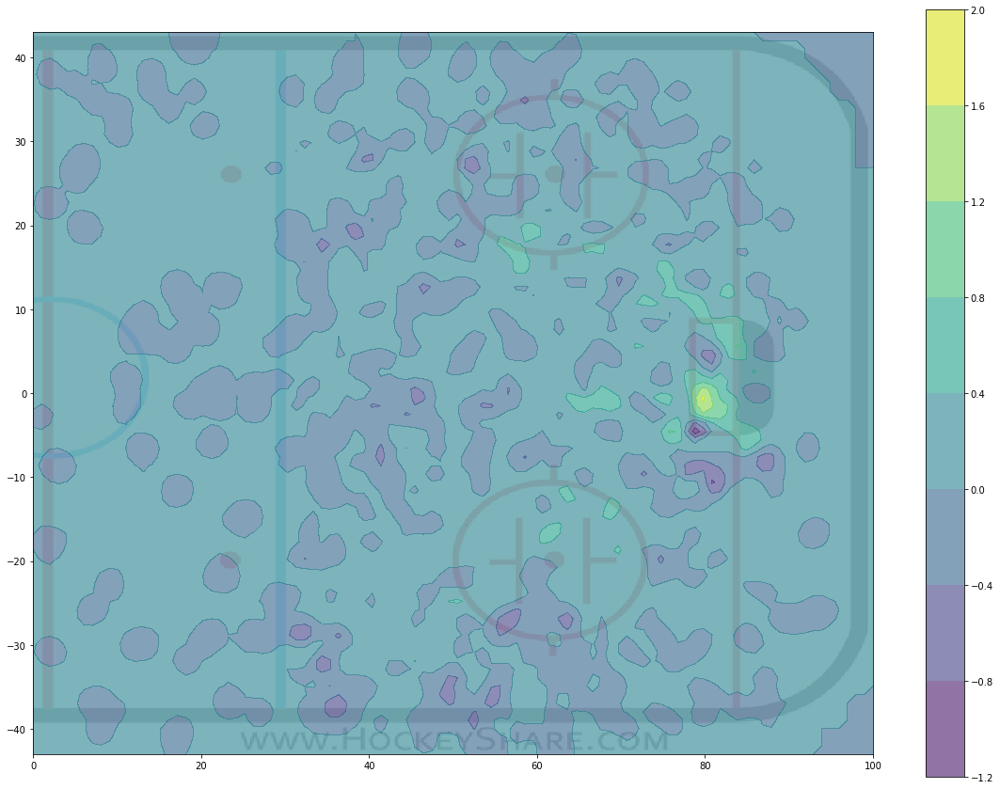

In [66]:
#hockey rink image reference: www.HockeyShare.com
plt.rcParams["figure.figsize"] = (20,15)
plt.contourf(data, alpha=0.6, extent=[0, 100, -43, 43])
plt.colorbar()
plt.imshow(plt.imread(r'/Users/henaghonia/Desktop/udem/Sem 1/Data science/Hockey-all-star-analytics//reports/half_rink_diagram.jpeg'), interpolation='nearest', 
                         alpha=0.2, extent=[0, 100, -43, 43])

plt.xlabel('Distance from goal line(ft)')
plt.ylabel('Distance from the rink(ft)')
plt.show()

In [39]:
df.team_initiative_name.unique()

array(['Columbus Blue Jackets', 'St. Louis Blues', 'Boston Bruins',
       'New Jersey Devils', 'Philadelphia Flyers', 'Washington Capitals',
       'Carolina Hurricanes', 'Montréal Canadiens', 'Dallas Stars',
       'Edmonton Oilers', 'Calgary Flames', 'Arizona Coyotes',
       'Los Angeles Kings', 'Nashville Predators', 'Florida Panthers',
       'Buffalo Sabres', 'Ottawa Senators', 'New York Rangers',
       'New York Islanders', 'Pittsburgh Penguins', 'Detroit Red Wings',
       'Tampa Bay Lightning', 'Minnesota Wild', 'Colorado Avalanche',
       'Winnipeg Jets', 'Anaheim Ducks', 'San Jose Sharks',
       'Vancouver Canucks', 'Chicago Blackhawks', 'Toronto Maple Leafs',
       'Team Pacific', 'Team Central', 'Team Metropolitan',
       'Team Atlantic', 'Vegas Golden Knights', 'Canadian All-Stars',
       'American All-Stars'], dtype=object)

In [15]:
df[df['team_initiative_name']=='Tampa Bay Lightning'].head()

,event_idx,event_type_id,period_idx,period_type,game_time,shot_type,team_initiative_id,team_initiative_name,x_coord,y_coord,shooter_id,shooter_name,goalie_id,goalie_name,strength,empty_net_bool,gamePk,game_season,game_type,game_start_time
1001,8,SHOT,1,REGULAR,2016-09-27T23:39:59Z,Wrist Shot,TBL,Tampa Bay Lightning,-60.0,-27.0,8476195,Cory Conacher,8470320.0,Cam Ward,NaN,NaN,2016010025,20162017,PR,2016-09-27T23:30:00Z
1003,13,SHOT,1,REGULAR,2016-09-27T23:42:42Z,Wrist Shot,TBL,Tampa Bay Lightning,-58.0,21.0,8478147,Bokondji Imama,8470320.0,Cam Ward,NaN,NaN,2016010025,20162017,PR,2016-09-27T23:30:00Z
1004,12,SHOT,1,REGULAR,2016-09-27T23:42:17Z,Wrist Shot,TBL,Tampa Bay Lightning,-59.0,25.0,8478147,Bokondji Imama,8470320.0,Cam Ward,NaN,NaN,2016010025,20162017,PR,2016-09-27T23:30:00Z
1005,14,SHOT,1,REGULAR,2016-09-27T23:43:29Z,Slap Shot,TBL,Tampa Bay Lightning,-45.0,26.0,8473986,Alex Killorn,8470320.0,Cam Ward,NaN,NaN,2016010025,20162017,PR,2016-09-27T23:30:00Z
1006,15,SHOT,1,REGULAR,2016-09-27T23:43:44Z,Wrist Shot,TBL,Tampa Bay Lightning,-41.0,31.0,8470601,Braydon Coburn,8470320.0,Cam Ward,NaN,NaN,2016010025,20162017,PR,2016-09-27T23:30:00Z


In [10]:
from ipywidgets import interact, interactive, fixed
import ipywidgets as widgets
season_dropDown = widgets.Dropdown(
    options= list(df['game_season'].unique()),
   # value='20162017',
    description='Season:',
)
team_dropDown = widgets.Dropdown(
    options=list(df['team_initiative_id'].unique()),
    #value='CBJ',
    description='team id:',
)

In [31]:
df[(df['game_season']==20162017)].head()

,event_idx,event_type_id,period_idx,period_type,game_time,shot_type,team_initiative_id,team_initiative_name,x_coord,y_coord,shooter_id,shooter_name,goalie_id,goalie_name,strength,empty_net_bool,gamePk,game_season,game_type,game_start_time
0,53,SHOT,1,REGULAR,2016-09-25T17:09:01Z,Wrist Shot,CBJ,Columbus Blue Jackets,40.0,-25.0,8472338,Jaime Sifers,8474596.0,Jake Allen,NaN,NaN,2016010002,20162017,PR,2016-09-25T17:00:00Z
1,58,SHOT,1,REGULAR,2016-09-25T17:13:53Z,Backhand,CBJ,Columbus Blue Jackets,82.0,5.0,8470302,Patrick Dwyer,8474596.0,Jake Allen,NaN,NaN,2016010002,20162017,PR,2016-09-25T17:00:00Z
2,62,SHOT,1,REGULAR,2016-09-25T17:15:16Z,Wrist Shot,STL,St. Louis Blues,-65.0,-14.0,8476989,Petteri Lindbohm,8476914.0,Joonas Korpisalo,NaN,NaN,2016010002,20162017,PR,2016-09-25T17:00:00Z
3,63,SHOT,1,REGULAR,2016-09-25T17:15:30Z,Wrist Shot,CBJ,Columbus Blue Jackets,8.0,25.0,8474040,Sam Gagner,8474596.0,Jake Allen,NaN,NaN,2016010002,20162017,PR,2016-09-25T17:00:00Z
4,67,SHOT,1,REGULAR,2016-09-25T17:17:55Z,Wrist Shot,CBJ,Columbus Blue Jackets,63.0,19.0,8477430,Nick Moutrey,8474596.0,Jake Allen,NaN,NaN,2016010002,20162017,PR,2016-09-25T17:00:00Z


In [36]:
def plotit(season_dropDown, team_dropDown):
    dff = df[(df['game_season']==season_dropDown)]
    team = league_team(dff, team_dropDown, league_avg(dff)) 
    sigma = 0.7
    print(season_dropDown, team_dropDown)
    data = gaussian_filter(team, sigma)
    plt.rcParams["figure.figsize"] = (20,10)
    plt.contourf(data, alpha=0.8, extent=[100, -1, -43, 43])
    plt.colorbar()
    
    plt.imshow(plt.imread(r'/Users/henaghonia/Desktop/udem/Sem-1/Data-science/Hockey-all-star-analytics//reports/half_rink_diagram.jpeg'), interpolation='nearest', 
                             alpha=0.4, extent=[100, -1, -43, 43])
    plt.xlabel('Distance from goal line(ft)', fontsize=18)
    plt.ylabel('Distance from the rink(ft)',fontsize=18)
    plt.show()
    
interactive(plotit, season_dropDown=season_dropDown, team_dropDown=team_dropDown)  

#filename = '/Users/henaghonia/Desktop/udem/Sem 1/Data science/ift6758-blog-template-main/_includes/Q6.html'
#q4 BUF( Buffalo Sabres) vs Tampa Bay Lightning(TBL)
#q3 Colorado Avalanche (COL) 


interactive(children=(Dropdown(description='Season:', index=4, options=(20162017, 20172018, 20182019, 20192020…